In [1]:
import numpy as np
import librosa
import librosa.display
import soundfile as sf
import pandas as pd
import os
import IPython.display as ipd
from pathlib import *
import matplotlib.pyplot as plt
from Preprocess import * 
import glob

In [2]:
INPUT_PATH = Path('/net/store/cbc/projects/Pan troglodytes/audio_PH_dataset/PH/good_data/')
file_path =  '/net/store/cv/users/ybrima/scratch/data/Luango_Speaker/clip_loango.npz'
BASE_PATH =  '/net/store/cv/users/ybrima/scratch/data/Luango_Speaker/'
CLEAN_PATH =  Path(BASE_PATH,'good_data')
CLASSES = os.listdir(INPUT_PATH)
FRAME_LENGHT =  512
SAMPLE_RATE =  44100
HOP_LENGTH =  128

In [3]:
df = get_files(INPUT_PATH)

68 files read successfully


In [4]:
df

,file,class,label,duration
0,/net/store/cbc/projects/Pan troglodytes/audio_...,0,PAN,40.105215
1,/net/store/cbc/projects/Pan troglodytes/audio_...,0,PAN,9.431655
2,/net/store/cbc/projects/Pan troglodytes/audio_...,0,PAN,21.143220
3,/net/store/cbc/projects/Pan troglodytes/audio_...,0,PAN,17.011519
4,/net/store/cbc/projects/Pan troglodytes/audio_...,0,PAN,22.009615
...,...,...,...,...
63,/net/store/cbc/projects/Pan troglodytes/audio_...,8,NGO,19.622313
64,/net/store/cbc/projects/Pan troglodytes/audio_...,9,CHI,2.996372
65,/net/store/cbc/projects/Pan troglodytes/audio_...,9,CHI,2.631995
66,/net/store/cbc/projects/Pan troglodytes/audio_...,9,CHI,4.337596


In [5]:
# df = get_files_updated(INPUT_PATH)

In [6]:
r = df.sample(n=1)
f = str(r.loc[r.index[0]][0])
x, sr = librosa.load(f,sr=None)
f

'/net/store/cbc/projects/Pan troglodytes/audio_PH_dataset/PH/good_data/CHE/clip8_loango_181126_10;14;42_CHE,AR (PA)_ph,dr (rp)_gm_ir.wav'

In [7]:
librosa.get_duration(x,sr)

57.456326530612245

In [8]:
ipd.Audio(Path(f))

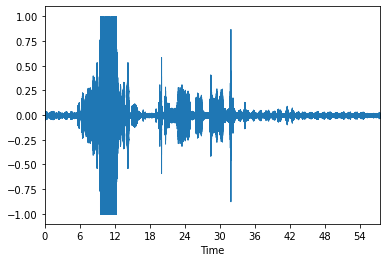

In [11]:
librosa.display.waveplot(x,sr=sr)
plt.show()

In [12]:
y, sr = librosa.load(f, offset=17.0,sr=None) #duration=5.0
yy, sr = librosa.load(f, duration=17.0,sr=None) #duration=5.0

In [13]:
sf.write('lara.wav',y,sr)

In [14]:
frames =  np.arange(0,len(x))
time =  librosa.frames_to_time(frames,sr=sr)

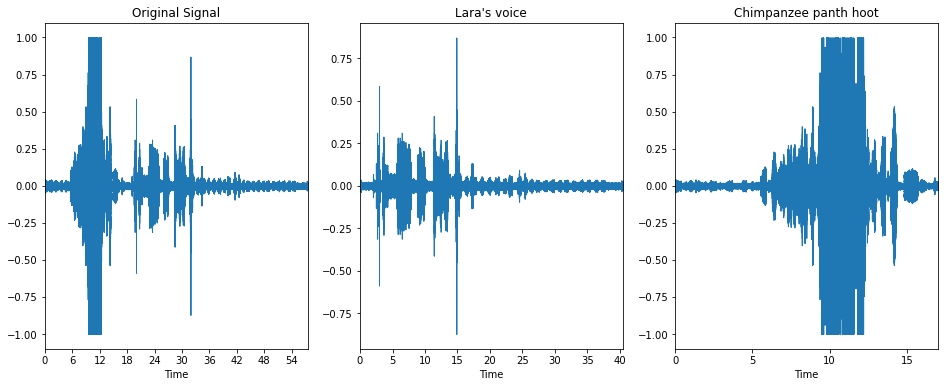

In [15]:
plt.figure(1,figsize=(16,6))
plt.subplot(1,3,1)
plt.title("Original Signal")
librosa.display.waveplot(x,sr=sr)
plt.subplot(1,3,2)
plt.title("Lara's voice")
librosa.display.waveplot(y,sr=sr)

plt.subplot(1,3,3)
plt.title("Chimpanzee panth hoot")
librosa.display.waveplot(yy,sr=sr)
plt.show()

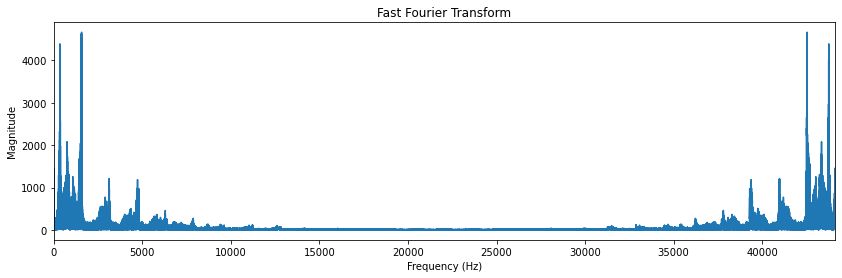

In [16]:
ft =  np.fft.fft(yy)
magnitude =  abs(ft)
freq =  np.linspace(0,sr,len(magnitude))

plt.figure(1,figsize=(14,4))
plt.plot(freq,magnitude)
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")
plt.xlim([0,max(freq)])
plt.title("Fast Fourier Transform")
plt.show()

In [17]:
D = librosa.amplitude_to_db(np.abs(librosa.stft(yy,hop_length=HOP_LENGTH)), ref=np.max)
D2 = librosa.amplitude_to_db(np.abs(librosa.stft(x,hop_length=HOP_LENGTH)), ref=np.max)

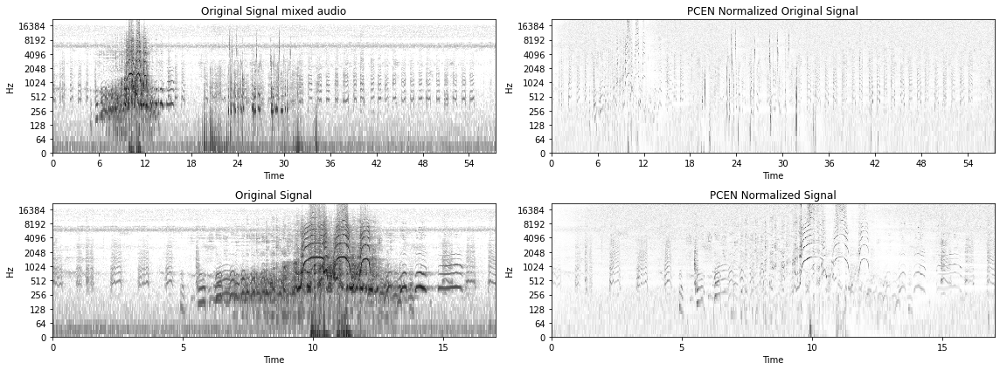

In [22]:
plt.figure(1,figsize=(16,6))
plt.subplot(2,2,1)
plt.title("Original Signal mixed audio")
librosa.display.specshow(D2, y_axis='log',sr=sr,hop_length=HOP_LENGTH, x_axis='time',cmap='gray_r')

plt.subplot(2,2,2)
plt.title("PCEN Normalized Original Signal")
librosa.display.specshow(librosa.pcen(np.abs(librosa.stft(x,hop_length=HOP_LENGTH)), sr=sr, hop_length=HOP_LENGTH), y_axis='log',x_axis='time',sr=sr,hop_length=HOP_LENGTH,cmap='gray_r')
plt.subplot(2,2,3)
plt.title("Original Signal")
librosa.display.specshow(D, y_axis='log',sr=sr,hop_length=HOP_LENGTH, x_axis='time',cmap='gray_r')
plt.subplot(2,2,4)
plt.title("PCEN Normalized Signal")
librosa.display.specshow(librosa.pcen(np.abs(librosa.stft(yy,hop_length=HOP_LENGTH)), sr=sr, hop_length=HOP_LENGTH), y_axis='log',x_axis='time',sr=sr,hop_length=HOP_LENGTH, cmap='gray_r')
plt.tight_layout()
plt.show()

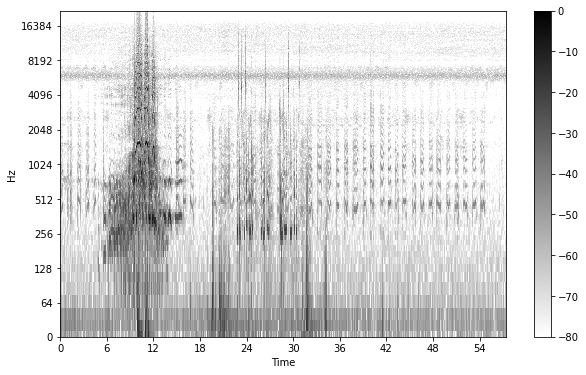

In [32]:
X = librosa.stft(x,hop_length=HOP_LENGTH)
Xmag = np.abs(X)
plt.figure(figsize=(10,6))
librosa.display.specshow(librosa.amplitude_to_db(Xmag,ref=np.max), sr=sr,hop_length=HOP_LENGTH, x_axis='time', y_axis='log', cmap='gray_r')
plt.colorbar()

In [ ]:
# read_data()

In [49]:
df =  lambda sr,k: (1/sr)*k

In [50]:
sr =  44100
K =  np.array([ np.power(2,x) for x in range(0,10)])
y =  np.array([ df(sr,k) for k in K])

Text(0, 0.5, 'Duration (ms)')

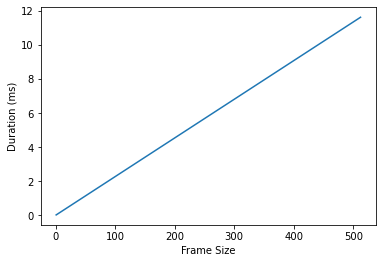

In [58]:
plt.plot(K,y*1000)
plt.xlabel("Frame Size")
plt.ylabel("Duration (ms)")

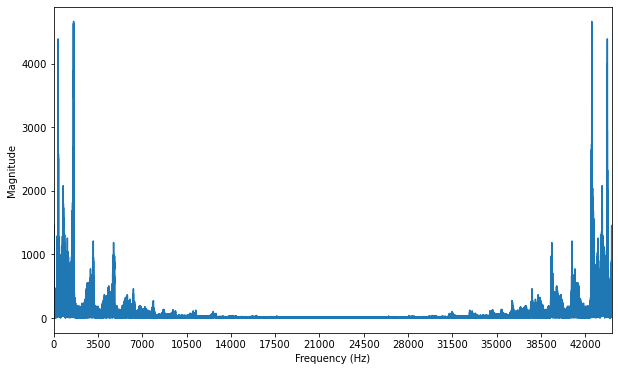

In [69]:
plt.figure(1,figsize=(10,6))
mag =  abs(np.fft.fft(yy))
freq =  np.linspace(0,sr,len(mag))
plt.plot(freq,mag)
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")
plt.xticks(np.arange(min(freq), max(freq)+1, 3500.0))
plt.xlim([0,max(freq)])
plt.show()

In [91]:
import tensorflow.keras.backend as K
import tensorflow.keras as keras

In [107]:
input = keras.Input(shape=(None, None,1))
x = keras.layers.Conv2D(filters = 16,kernel_size=(3,3), padding='valid',activation='relu')(input)
x = keras.layers.MaxPool2D(pool_size=(2,2))(x)
x = keras.layers.Conv2D(filters = 32,kernel_size=(3,3), padding='valid',activation='relu')(x)
x = keras.layers.Conv2D(filters = 32,kernel_size=(3,3), padding='valid',activation='relu')(x)
x = keras.layers.MaxPool2D(pool_size=(2,2))(x)
x = keras.layers.Conv2D(filters = 64,kernel_size=(3,3), padding='valid',activation='relu')(x)
x = keras.layers.Conv2D(filters = 64,kernel_size=(3,3), padding='valid',activation='relu')(x)
x =  keras.layers.GlobalAveragePooling2D()(x)
x = keras.layers.Flatten()(x)
x = keras.layers.Dense(2, activation='softmax',name='activatioon')(x)
model = keras.Model(inputs = input, outputs= x)
model.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['accuracy'])


In [108]:
model.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_14 (InputLayer)       [(None, None, None, 1)]   0         
                                                                 
 conv2d_14 (Conv2D)          (None, None, None, 16)    160       
                                                                 
 max_pooling2d_5 (MaxPooling  (None, None, None, 16)   0         
 2D)                                                             
                                                                 
 conv2d_15 (Conv2D)          (None, None, None, 32)    4640      
                                                                 
 conv2d_16 (Conv2D)          (None, None, None, 32)    9248      
                                                                 
 max_pooling2d_6 (MaxPooling  (None, None, None, 32)   0         
 2D)                                                       

In [110]:
from sklearn.datasets import make_classification


In [112]:
X,y = make_classification(n_samples=100,n_features=16,n_classes=2)

In [113]:
# model.fit(x=X,y=y, batch_size=1,)

In [115]:
p = Path('/net/store/cbc/projects/Pan troglodytes/audio_PH_dataset/PH/good_data')

In [117]:
os.listdir(str(p))

['PAN',
 'THE',
 'GUM',
 'ARN',
 'CHE',
 'FRE',
 'LIT',
 'LOU',
 'NGO',
 'CHI',
 'ROX',
 'CAR']

In [120]:
t = 0
for c in os.listdir(str(p)):
    path =  Path(p,c)
    t +=  len(os.listdir(str(path)))
    print(f"{path} total = {len(os.listdir(str(path)))}")
print(f"File count {t}")

/net/store/cbc/projects/Pan troglodytes/audio_PH_dataset/PH/good_data/PAN total = 22
/net/store/cbc/projects/Pan troglodytes/audio_PH_dataset/PH/good_data/THE total = 23
/net/store/cbc/projects/Pan troglodytes/audio_PH_dataset/PH/good_data/GUM total = 2
/net/store/cbc/projects/Pan troglodytes/audio_PH_dataset/PH/good_data/ARN total = 10
/net/store/cbc/projects/Pan troglodytes/audio_PH_dataset/PH/good_data/CHE total = 14
/net/store/cbc/projects/Pan troglodytes/audio_PH_dataset/PH/good_data/FRE total = 16
/net/store/cbc/projects/Pan troglodytes/audio_PH_dataset/PH/good_data/LIT total = 10
/net/store/cbc/projects/Pan troglodytes/audio_PH_dataset/PH/good_data/LOU total = 10
/net/store/cbc/projects/Pan troglodytes/audio_PH_dataset/PH/good_data/NGO total = 9
/net/store/cbc/projects/Pan troglodytes/audio_PH_dataset/PH/good_data/CHI total = 6
/net/store/cbc/projects/Pan troglodytes/audio_PH_dataset/PH/good_data/ROX total = 2
/net/store/cbc/projects/Pan troglodytes/audio_PH_dataset/PH/good_data